In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import skew, kurtosis
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import IsolationForest
import joblib

In [ ]:
file_path = "vibration_raw_data_all.csv"
chunksize = 1_000_000
chunks = []

float_cols = ["xs","ys","zs","xd","yd","zd","xa","ya","za"]

for chunk in pd.read_csv(file_path, chunksize=chunksize):
    #column name clean
    chunk.columns = chunk.columns.str.strip().str.lower()

    # drop unwanted columns
    chunk = chunk.drop(columns=["temperature", "sent_to_s3"], errors='ignore')

    # drop null and dubplicate data
    chunk = chunk.dropna()
    chunk = chunk.drop_duplicates()

    # convert time format and drop null time
    chunk["timestamp"] = pd.to_datetime(chunk["timestamp"], errors='coerce')
    chunk = chunk.dropna(subset=["timestamp"])

    for col in float_cols:
        chunk[col] = pd.to_numeric(chunk[col], errors='coerce')

    chunks.append(chunk)

df = pd.concat(chunks, ignore_index=True)
df.head()

,timestamp,device_id,sensor_id,xs,ys,zs,xd,yd,zd,xa,ya,za
0,2025-08-26 14:06:05.800,L2,22,0.02,0.02,0.02,0.0,0.0,0.0,0.0,0.0,7.7
1,2025-08-26 14:06:05.772,L2,22,0.02,0.02,0.02,0.0,0.0,0.0,0.0,0.0,7.7
2,2025-08-26 14:06:05.765,L2,22,0.02,0.02,0.02,0.0,0.0,0.0,0.0,0.0,7.7
3,2025-08-26 14:06:05.740,L2,22,0.02,0.03,0.02,0.0,0.0,0.0,0.0,0.0,7.7
4,2025-08-26 14:06:05.717,L2,22,0.02,0.03,0.02,0.0,0.0,0.0,0.0,0.0,7.7


In [ ]:

print(len(df))

10462499


In [ ]:
sensor9_df = df[df['sensor_id'] == 9]
fig = px.line(sensor9_df, x='timestamp', y='xs',
              title='Sensor 9 - Vibration Spike (xs axis)',
              labels={'xs':'Vibration', 'timestamp':'Time'})

fig.show()

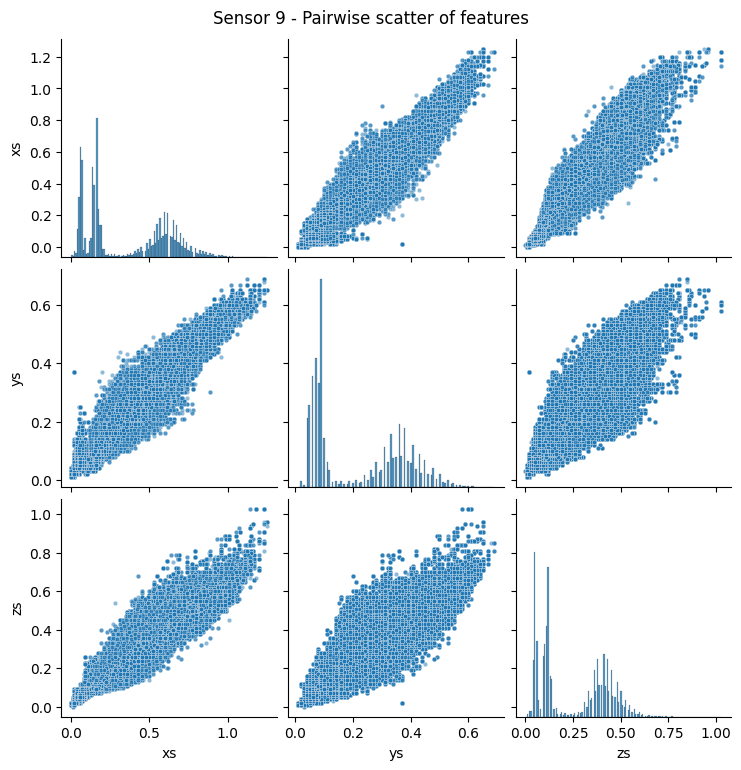

In [ ]:
sns.pairplot(sensor9_df, vars=['xs','ys','zs'], plot_kws={'s':10, 'alpha':0.5})
plt.suptitle('Sensor 9 - Pairwise scatter of features', y=1.02)
plt.show()

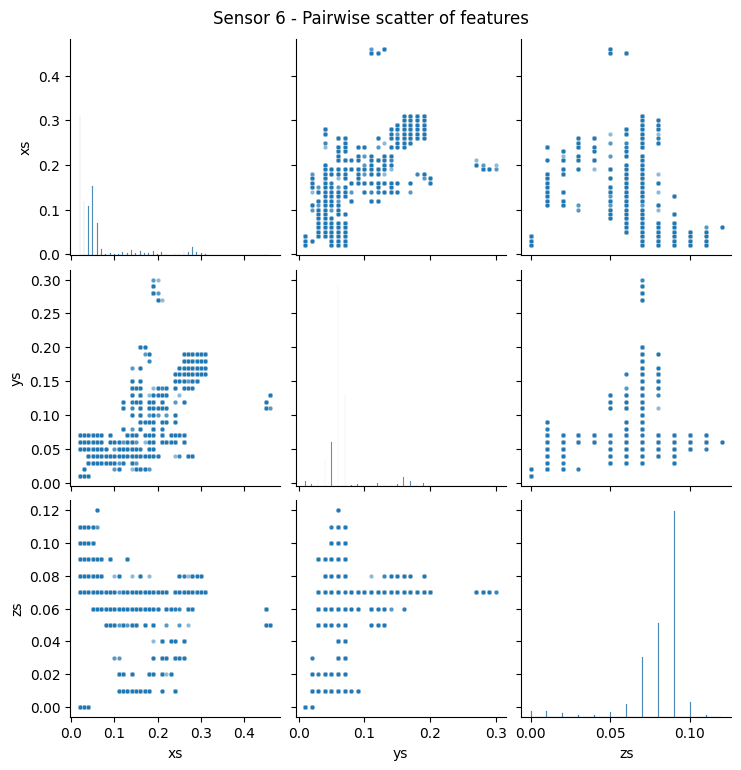

In [ ]:
sensor6_df = df[df['sensor_id'] == 6]
sns.pairplot(sensor6_df, vars=['xs','ys','zs'], plot_kws={'s':10, 'alpha':0.5})
plt.suptitle('Sensor 6 - Pairwise scatter of features', y=1.02)
plt.show()

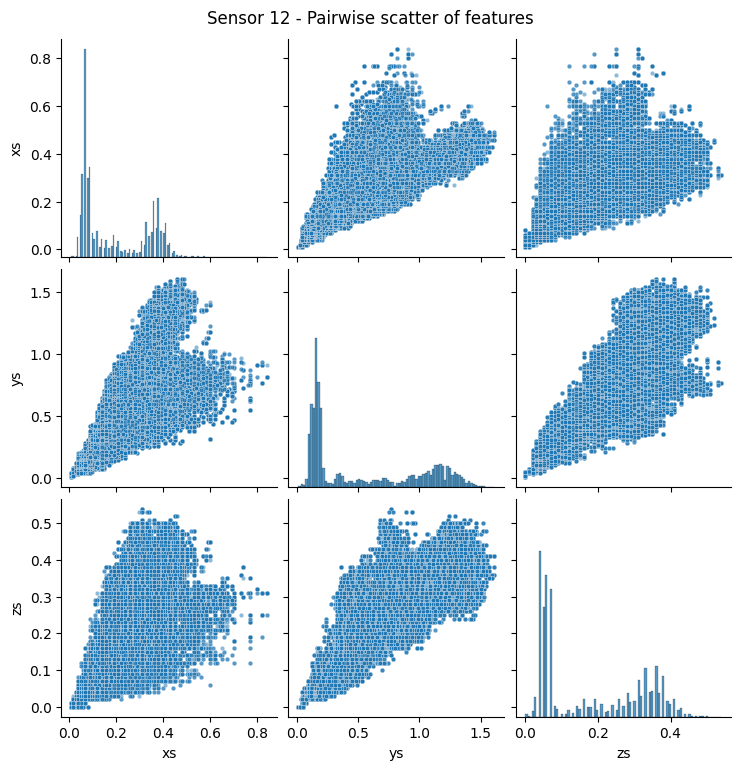

In [ ]:
sensor12_df = df[df['sensor_id'] == 12]
sns.pairplot(sensor12_df, vars=['xs','ys','zs'], plot_kws={'s':10, 'alpha':0.5})
plt.suptitle('Sensor 12 - Pairwise scatter of features', y=1.02)
plt.show()

In [ ]:
df['gap'] = df.groupby('sensor_id')['timestamp'].diff().dt.total_seconds().fillna(0)

# Set threshold per sensor: median gap * 2, min 0.05s
sensor_thresholds = df.groupby('sensor_id')['gap'].median().fillna(0.05)
sensor_thresholds = sensor_thresholds.apply(lambda x: max(x*2, 0.05))

def assign_burst(sensor_g):
    sid = sensor_g['sensor_id'].iloc[0]
    threshold = sensor_thresholds.get(sid, 0.05)
    return (sensor_g['gap'] > threshold).cumsum()

df['burst_id'] = df.groupby('sensor_id', group_keys=False).apply(assign_burst)
df['burst_id'] = df['sensor_id'].astype(str) + "_" + df['burst_id'].astype(str)


/tmp/ipython-input-1903872078.py:12: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df['burst_id'] = df.groupby('sensor_id', group_keys=False).apply(assign_burst)


In [ ]:
# Define window inside bursts
window_size = 50
data_cols = ['xs','ys','zs']

df['burst_index'] = df.groupby(['sensor_id','burst_id']).cumcount()
df['window_index'] = df['burst_index'] // window_size

In [ ]:
data_cols = ['xs','ys','zs']
group_cols = ['sensor_id','burst_id','window_index']

agg_dict = {col: ['mean', 'std', 'max', 'min', 'median'] for col in data_cols}
features_basic = df.groupby(group_cols, sort=False).agg(agg_dict)
features_basic.columns = ['_'.join(col).strip() for col in features_basic.columns.values]
features_basic.reset_index(inplace=True)

# Vectorized RMS, p2p, energy
def calc_rms(x): return np.sqrt(np.mean(x**2))
def calc_p2p(x): return np.max(x) - np.min(x)
def calc_energy(x): return np.sum(x**2) / len(x)

features_extra = df.groupby(group_cols, sort=False)[data_cols].agg([
    calc_rms, calc_p2p, pd.Series.skew, pd.Series.kurt, calc_energy
])
# Rename columns
features_extra.columns = [f"{col[0]}_{col[1]}" for col in features_extra.columns]
features_extra.reset_index(inplace=True)

# Combine basic + extra features
features = features_basic.merge(features_extra, on=group_cols, how='left')

features['timestamp'] = df.groupby(group_cols)['timestamp'].first().values

print("Number of feature rows:", len(features))
print("Feature columns:", [c for c in features.columns if c not in group_cols + ['timestamp']])


Number of feature rows: 209266
Feature columns: ['xs_mean', 'xs_std', 'xs_max', 'xs_min', 'xs_median', 'ys_mean', 'ys_std', 'ys_max', 'ys_min', 'ys_median', 'zs_mean', 'zs_std', 'zs_max', 'zs_min', 'zs_median', 'xs_calc_rms', 'xs_calc_p2p', 'xs_skew', 'xs_kurt', 'xs_calc_energy', 'ys_calc_rms', 'ys_calc_p2p', 'ys_skew', 'ys_kurt', 'ys_calc_energy', 'zs_calc_rms', 'zs_calc_p2p', 'zs_skew', 'zs_kurt', 'zs_calc_energy']


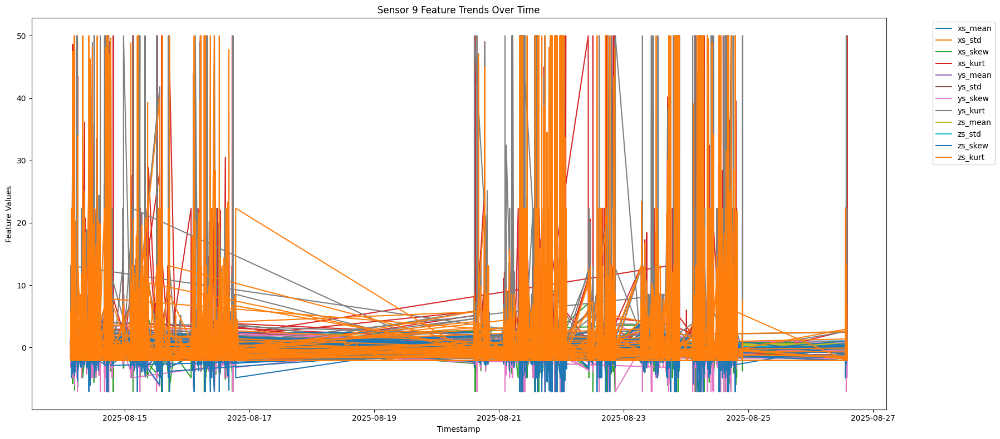

In [ ]:
sensor_id = 9

# Filter sensor data
sensor_features = features[features['sensor_id'] == sensor_id].copy()

plt.figure(figsize=(18, 8))

# Plot feature aggregates: mean, RMS, energy, std, p2p, skew, kurtosis
feature_types = ['mean', 'rms', 'energy', 'std', 'p2p', 'skew', 'kurt']
for col in ['xs', 'ys', 'zs']:
    for ftype in feature_types:
        feature_col = f"{col}_{ftype}"
        if feature_col in sensor_features.columns:
            plt.plot(sensor_features['timestamp'], sensor_features[feature_col], label=feature_col)

plt.xlabel('Timestamp')
plt.ylabel('Feature Values')
plt.title(f'Sensor {sensor_id} Feature Trends Over Time')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


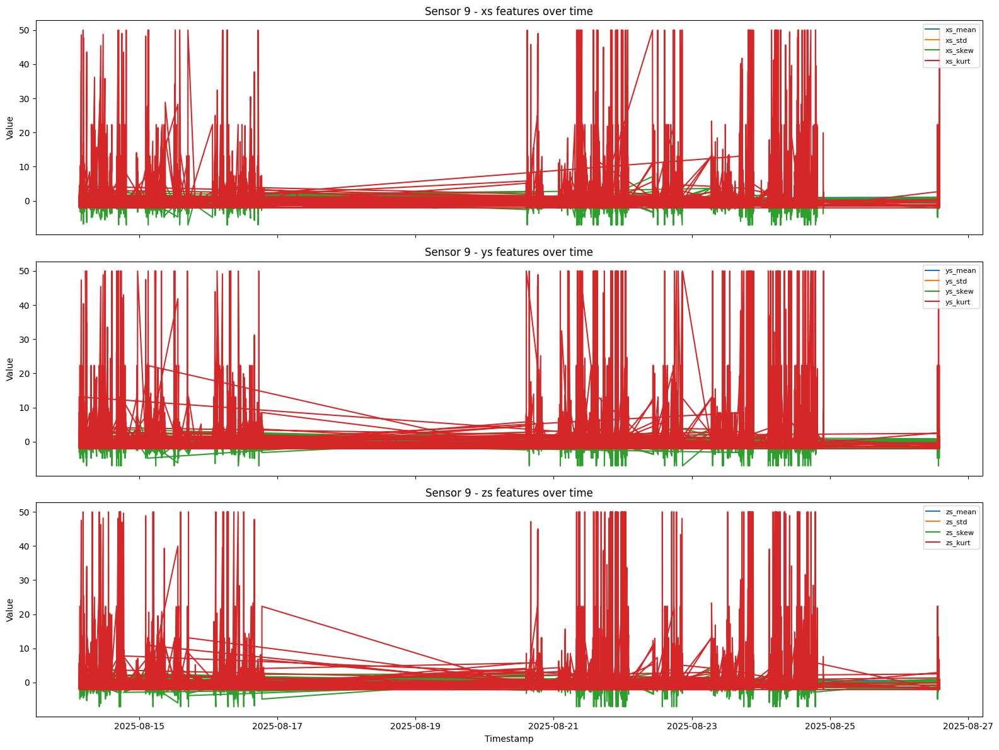

In [ ]:
sensor_id = 9
sensor_features = features[features['sensor_id'] == sensor_id].copy()

feature_types = ['mean', 'std', 'rms', 'p2p', 'skew', 'kurt', 'energy']

fig, axes = plt.subplots(3, 1, figsize=(16, 12), sharex=True)

for i, col in enumerate(['xs', 'ys', 'zs']):
    ax = axes[i]
    for ftype in feature_types:
        feat_col = f'{col}_{ftype}'
        if feat_col in sensor_features.columns:
            ax.plot(sensor_features['timestamp'], sensor_features[feat_col], label=feat_col)
    ax.set_title(f'Sensor {sensor_id} - {col} features over time')
    ax.set_ylabel('Value')
    ax.legend(loc='upper right', fontsize=8)

axes[-1].set_xlabel('Timestamp')
plt.tight_layout()
plt.show()


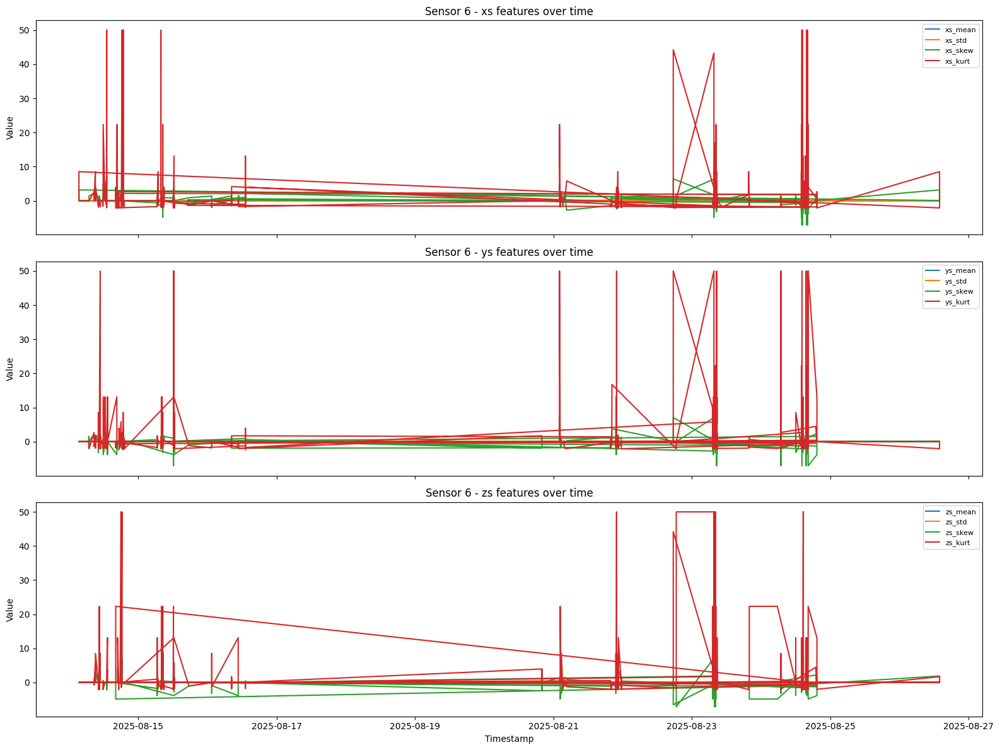

In [ ]:
sensor_id = 6
sensor_features = features[features['sensor_id'] == sensor_id].copy()

feature_types = ['mean', 'std', 'rms', 'p2p', 'skew', 'kurt', 'energy']

fig, axes = plt.subplots(3, 1, figsize=(16, 12), sharex=True)

for i, col in enumerate(['xs', 'ys', 'zs']):
    ax = axes[i]
    for ftype in feature_types:
        feat_col = f'{col}_{ftype}'
        if feat_col in sensor_features.columns:
            ax.plot(sensor_features['timestamp'], sensor_features[feat_col], label=feat_col)
    ax.set_title(f'Sensor {sensor_id} - {col} features over time')
    ax.set_ylabel('Value')
    ax.legend(loc='upper right', fontsize=8)

axes[-1].set_xlabel('Timestamp')
plt.tight_layout()
plt.show()


In [ ]:
feature_cols = [c for c in features.columns if c not in ['sensor_id','burst_id','window_index','timestamp']]

# Scale features per sensor (vectorized)
scalers = {}
X_scaled_all = pd.DataFrame(index=features.index, columns=feature_cols, dtype=float)

for sid, g in features.groupby('sensor_id', sort=False):
    scaler = StandardScaler()
    X_scaled_all.loc[g.index] = scaler.fit_transform(g[feature_cols])
    scalers[sid] = scaler

# Fit Isolation Forest per sensor
features['anomaly'] = 0
features['anomaly_score'] = 0.0  # new column to store score
models = {}

for sid, g in features.groupby('sensor_id', sort=False):
    X_sensor = X_scaled_all.loc[g.index].values

    model = IsolationForest(
        n_estimators=200,
        max_samples=min(1024, len(g)),
        contamination=0.01,
        random_state=42,
        n_jobs=-1
    )

    model.fit(X_sensor)
    preds = model.predict(X_sensor)

    # Mark anomalies
    features.loc[g.index, 'anomaly'] = (preds == -1).astype(bool)

    # Add anomaly score (decision_function)
    features.loc[g.index, 'anomaly_score'] = model.decision_function(X_sensor)

    models[sid] = model

# Save models and scalers
final_model = {
    'models': models,
    'scalers': scalers,
    'feature_cols': feature_cols
}
joblib.dump(final_model, 'isolation_forest_sensor_optimized.pkl')

# Summary
total_anomalies = int(features['anomaly'].sum())
print(f"Total anomalies detected: {total_anomalies}")
features[['sensor_id','timestamp','anomaly','anomaly_score']].head()


/tmp/ipython-input-1852505367.py:32: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[False False False ... False False False]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  features.loc[g.index, 'anomaly'] = (preds == -1).astype(bool)


Total anomalies detected: 2108


,sensor_id,timestamp,anomaly,anomaly_score
0,22,2025-08-24 20:49:33.157,False,0.220612
1,22,2025-08-24 20:49:32.326,False,0.179126
2,22,2025-08-24 20:49:31.084,False,0.210227
3,22,2025-08-23 00:07:55.472,False,0.209062
4,9,2025-08-22 22:31:36.965,False,0.179790


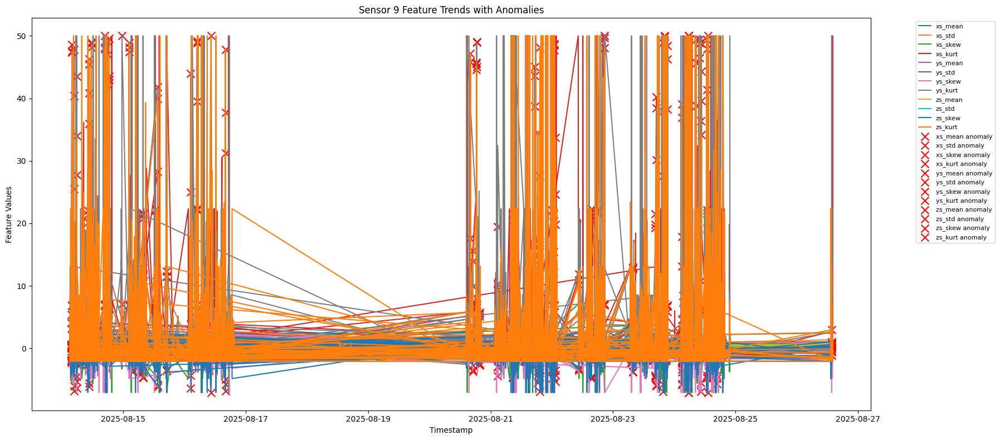

In [ ]:
sensor_id = 9

# Filter sensor data
sensor_features = features[features['sensor_id'] == sensor_id].copy()

plt.figure(figsize=(18, 8))

# Plot feature aggregates: mean, RMS, energy, std, p2p, skew, kurtosis
feature_types = ['mean', 'rms', 'energy', 'std', 'p2p', 'skew', 'kurt']
for col in ['xs', 'ys', 'zs']:
    for ftype in feature_types:
        feature_col = f"{col}_{ftype}"
        if feature_col in sensor_features.columns:
            plt.plot(sensor_features['timestamp'], sensor_features[feature_col], label=feature_col)

# Highlight anomalies
anomalies = sensor_features[sensor_features['anomaly'] == True]
for col in ['xs', 'ys', 'zs']:
    for ftype in feature_types:
        feature_col = f"{col}_{ftype}"
        if feature_col in sensor_features.columns:
            plt.scatter(
                anomalies['timestamp'],
                anomalies[feature_col],
                color='red',
                marker='x',
                s=100,
                label=f"{feature_col} anomaly"
            )

plt.xlabel('Timestamp')
plt.ylabel('Feature Values')
plt.title(f'Sensor {sensor_id} Feature Trends with Anomalies')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
plt.tight_layout()
plt.show()


['xs_calc_rms', 'ys_calc_rms', 'zs_calc_rms']


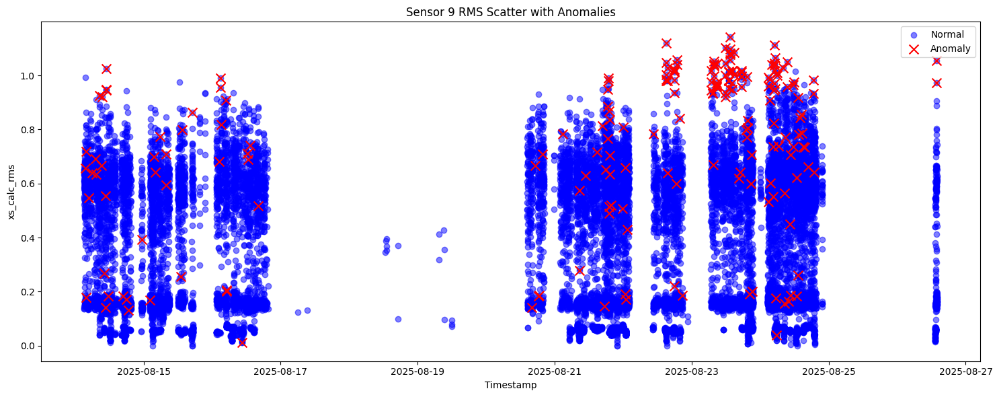

In [ ]:
sensor_id = 9
sensor_features = features[features['sensor_id'] == sensor_id].copy()

rms_col = 'xs_calc_rms'

plt.figure(figsize=(15,6))

plt.scatter(sensor_features['timestamp'], sensor_features[rms_col],
            color='blue', alpha=0.5, label='Normal')

anomalies = sensor_features[sensor_features['anomaly'] == True]
plt.scatter(anomalies['timestamp'], anomalies[rms_col],
            color='red', marker='x', s=100, label='Anomaly')

plt.xlabel("Timestamp")
plt.ylabel(rms_col)
plt.title(f"Sensor {sensor_id} RMS Scatter with Anomalies")
plt.legend()
plt.tight_layout()
plt.show()


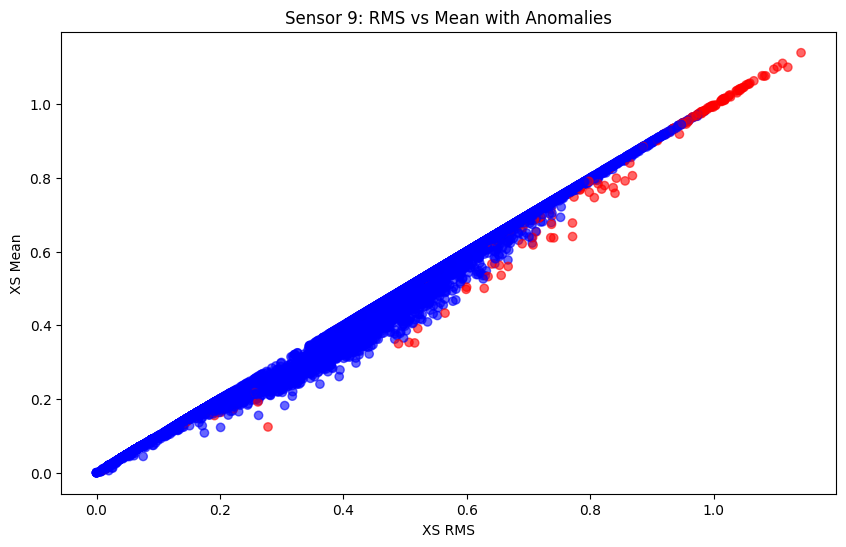

In [ ]:
plt.figure(figsize=(10,6))
plt.scatter(sensor_features['xs_calc_rms'], sensor_features['xs_mean'],
            c=sensor_features['anomaly'].map({False:'blue', True:'red'}), alpha=0.6)
plt.xlabel('XS RMS')
plt.ylabel('XS Mean')
plt.title(f'Sensor {sensor_id}: RMS vs Mean with Anomalies')
plt.show()


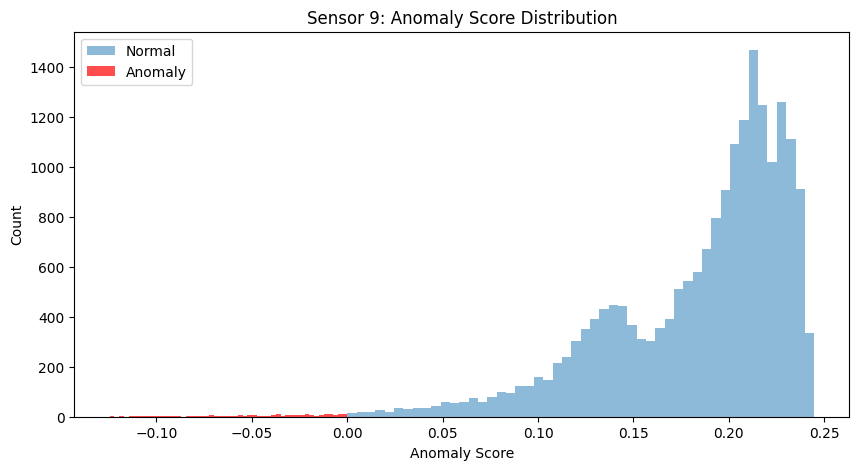

In [ ]:
plt.figure(figsize=(10,5))
plt.hist(sensor_features[sensor_features['anomaly']==False]['anomaly_score'], bins=50, alpha=0.5, label='Normal')
plt.hist(sensor_features[sensor_features['anomaly']==True]['anomaly_score'], bins=50, alpha=0.7, label='Anomaly', color='red')
plt.xlabel('Anomaly Score')
plt.ylabel('Count')
plt.title(f'Sensor {sensor_id}: Anomaly Score Distribution')
plt.legend()
plt.show()


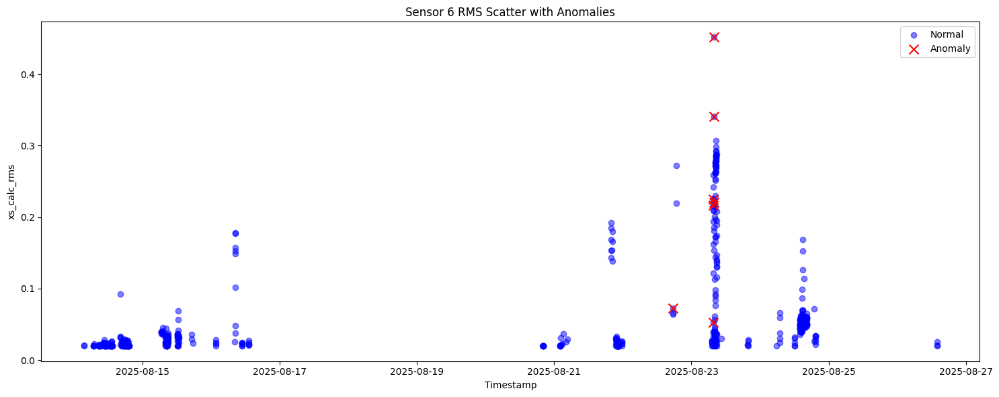

In [ ]:
sensor_id = 6
sensor_features = features[features['sensor_id'] == sensor_id].copy()

rms_col = 'xs_calc_rms'

plt.figure(figsize=(15,6))
plt.scatter(sensor_features['timestamp'], sensor_features[rms_col],
            color='blue', alpha=0.5, label='Normal')

anomalies = sensor_features[sensor_features['anomaly'] == True]
plt.scatter(anomalies['timestamp'], anomalies[rms_col],
            color='red', marker='x', s=100, label='Anomaly')

plt.xlabel("Timestamp")
plt.ylabel(rms_col)
plt.title(f"Sensor {sensor_id} RMS Scatter with Anomalies")
plt.legend()
plt.tight_layout()
plt.show()


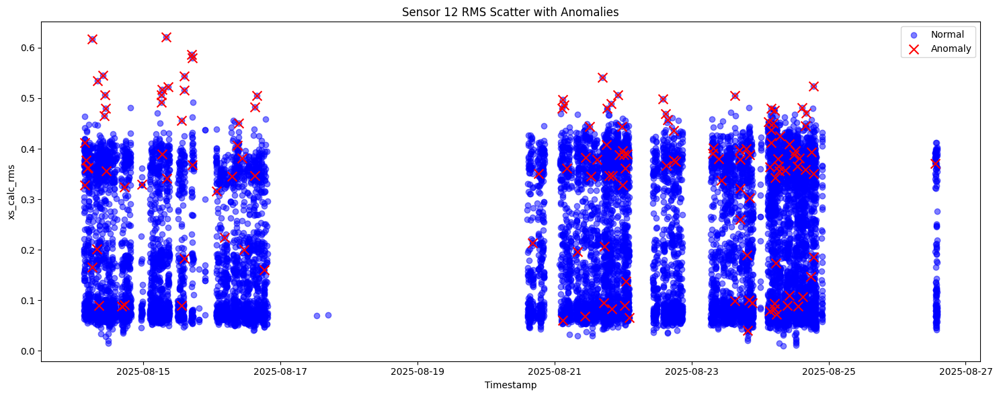

In [ ]:
sensor_id = 12
sensor_features = features[features['sensor_id'] == sensor_id].copy()

rms_col = 'xs_calc_rms'

plt.figure(figsize=(15,6))
plt.scatter(sensor_features['timestamp'], sensor_features[rms_col],
            color='blue', alpha=0.5, label='Normal')

anomalies = sensor_features[sensor_features['anomaly'] == True]
plt.scatter(anomalies['timestamp'], anomalies[rms_col],
            color='red', marker='x', s=100, label='Anomaly')

plt.xlabel("Timestamp")
plt.ylabel(rms_col)
plt.title(f"Sensor {sensor_id} RMS Scatter with Anomalies")
plt.legend()
plt.tight_layout()
plt.show()


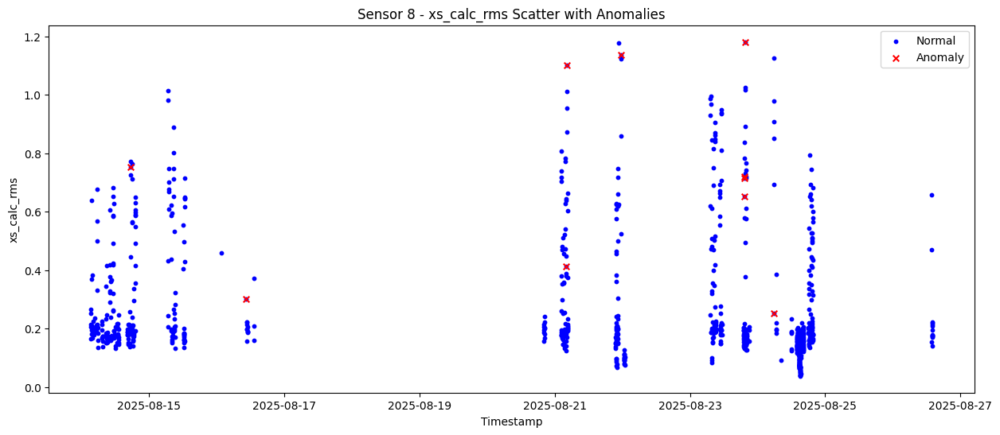

In [ ]:
sensor_id = 8
sensor_features = features[features['sensor_id'] == sensor_id].copy()

feature_col = [c for c in sensor_features.columns if 'xs' in c.lower() and 'rms' in c.lower()]
if not feature_col:
    raise ValueError("RMS feature not found")
feature_col = feature_col[0]

plt.figure(figsize=(15,6))

plt.scatter(sensor_features['timestamp'], sensor_features[feature_col], color='blue', s=10, label='Normal')

# Highlight anomalies
anomalies = sensor_features[sensor_features['anomaly'] == True]
plt.scatter(anomalies['timestamp'], anomalies[feature_col], color='red', s=30, marker='x', label='Anomaly')

plt.xlabel('Timestamp')
plt.ylabel(feature_col)
plt.title(f'Sensor {sensor_id} - {feature_col} Scatter with Anomalies')
plt.legend()
plt.show()


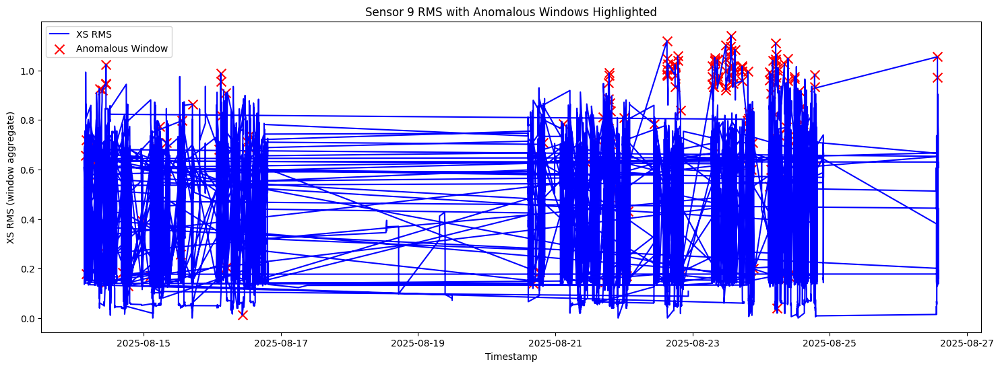

In [ ]:
sensor_id = 9

sensor_features = features[features['sensor_id'] == sensor_id].copy()
plt.figure(figsize=(18, 6))

plt.plot(sensor_features['timestamp'], sensor_features['xs_calc_rms'], label='XS RMS', color='blue')

# Highlight anomalous windows
anomalies = sensor_features[sensor_features['anomaly'] == True]
plt.scatter(anomalies['timestamp'], anomalies['xs_calc_rms'], color='red', label='Anomalous Window', marker='x', s=100)

plt.xlabel('Timestamp')
plt.ylabel('XS RMS (window aggregate)')
plt.title(f'Sensor {sensor_id} RMS with Anomalous Windows Highlighted')
plt.legend()
plt.show()


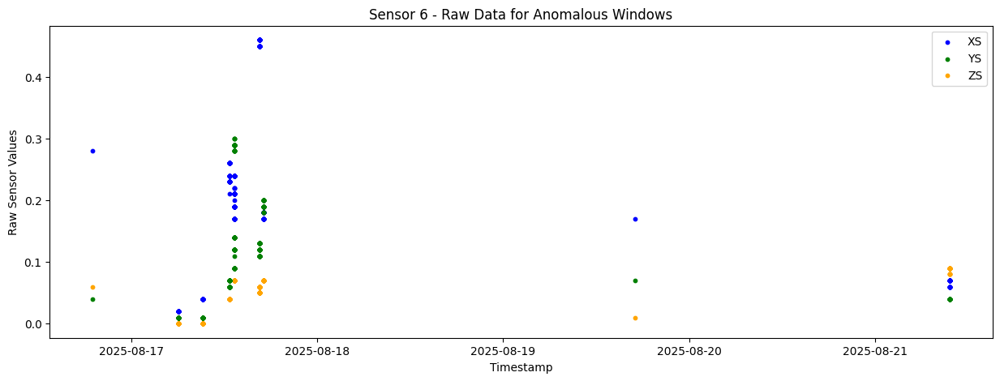

In [ ]:
sensor_id = 6

# Get anomalous windows for this sensor
anomalous_windows = features[(features['sensor_id'] == sensor_id) & (features['anomaly'] == True)]

plt.figure(figsize=(15, 5))

for idx, row in anomalous_windows.iterrows():
    start = row['start_time']
    end = row['end_time']

    # Filter raw data for this window
    window_data = df[(df['sensor_id'] == sensor_id) &
                     (df['timestamp'] >= start) &
                     (df['timestamp'] <= end)]

    # Plot raw signals (scatter)
    plt.scatter(window_data['timestamp'], window_data['xs'], color='blue', s=10, label='XS' if idx==anomalous_windows.index[0] else "")
    plt.scatter(window_data['timestamp'], window_data['ys'], color='green', s=10, label='YS' if idx==anomalous_windows.index[0] else "")
    plt.scatter(window_data['timestamp'], window_data['zs'], color='orange', s=10, label='ZS' if idx==anomalous_windows.index[0] else "")

plt.xlabel('Timestamp')
plt.ylabel('Raw Sensor Values')
plt.title(f'Sensor {sensor_id} - Raw Data for Anomalous Windows')
plt.legend()
plt.show()


In [ ]:
# Compute window start and end time per sensor-window
window_times = df.groupby(['sensor_id','burst_id','window_index'])['timestamp'].agg(['min','max']).reset_index()
window_times.rename(columns={'min': 'window_start', 'max': 'window_end'}, inplace=True)

# Merge with features
features_out = features.merge(window_times, on=['sensor_id','burst_id','window_index'], how='left')

# Select only required columns
cols_keep = ['sensor_id', 'window_start', 'window_end'] + feature_cols + ['anomaly', 'anomaly_score']
features_out = features_out[cols_keep]

# Save to CSV
features_out.to_csv('sensor_features_anomalies_clean.csv', index=False)
print("Clean output saved to sensor_features_anomalies_clean.csv")


Clean output saved to sensor_features_anomalies_clean.csv


In [ ]:
anomalies_df = pd.read_csv("sensor_features_anomalies_clean.csv")
anomalies_df.head()

,sensor_id,window_start,window_end,xs_mean,xs_std,xs_max,xs_min,xs_median,ys_mean,ys_std,...,ys_skew,ys_kurt,ys_calc_energy,zs_calc_rms,zs_calc_p2p,zs_skew,zs_kurt,zs_calc_energy,anomaly,anomaly_score
0,22,2025-08-26 14:06:04.419,2025-08-26 14:06:05.800,0.0268,0.004712,0.03,0.02,0.03,0.0220,0.004041,...,1.546796,0.407247,0.000500,0.02000,0.00,0.000000,0.000000,0.000400,False,0.220612
1,22,2025-08-26 14:06:03.796,2025-08-26 14:06:04.413,0.0204,0.001979,0.03,0.02,0.02,0.0168,0.004712,...,-0.795820,-1.425366,0.000304,0.02000,0.00,0.000000,0.000000,0.000400,False,0.179126
2,22,2025-08-26 14:06:03.308,2025-08-26 14:06:03.789,0.0200,0.000000,0.02,0.02,0.02,0.0222,0.004185,...,1.394027,-0.060755,0.000510,0.02000,0.00,0.000000,0.000000,0.000400,False,0.210227
3,22,2025-08-26 14:05:32.932,2025-08-26 14:06:03.301,0.0288,0.003283,0.03,0.02,0.03,0.0254,0.005035,...,-0.165522,-2.056566,0.000670,0.02000,0.00,0.000000,0.000000,0.000400,False,0.209062
4,9,2025-08-26 14:05:59.240,2025-08-26 14:06:00.994,0.1074,0.014115,0.12,0.09,0.12,0.0442,0.005379,...,-0.078001,-1.155677,0.001982,0.08951,0.03,-1.368473,2.459296,0.008012,False,0.179790


In [ ]:
total_anomalies = anomalies_df['anomaly'].sum()
print(total_anomalies)

2108
